In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("dasmehdixtr/drone-dataset-uav")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/drone-dataset-uav


In [3]:
import os

files = os.listdir("/kaggle/input/drone-dataset-uav/drone_dataset_yolo/dataset_txt")
print(files[:10])


['foto00378.txt', 'pic_1140.txt', 'pic_426.txt', 'pic_456.txt', 'pic_243.jpg', 'pic_772.jpg', 'yoto10702.txt', 'pic_743.txt', 'pic_397.txt', 'pic_098.jpg']


In [4]:
import os
import shutil
from sklearn.model_selection import train_test_split

input_path = "/kaggle/input/drone-dataset-uav/drone_dataset_yolo/dataset_txt"

# Список файлов-картинок
jpg_files = [f for f in os.listdir(input_path) if f.endswith('.jpg')]

# Разбиваем
train_files, val_files = train_test_split(jpg_files, test_size=0.2, random_state=42)

# Создаём папки
os.makedirs('/kaggle/working/dataset/images/train', exist_ok=True)
os.makedirs('/kaggle/working/dataset/images/val', exist_ok=True)
os.makedirs('/kaggle/working/dataset/labels/train', exist_ok=True)
os.makedirs('/kaggle/working/dataset/labels/val', exist_ok=True)

# Копируем train
for file in train_files:
    shutil.copy(os.path.join(input_path, file), f"/kaggle/working/dataset/images/train/{file}")
    label_file = file.replace('.jpg', '.txt')
    if os.path.exists(os.path.join(input_path, label_file)):
        shutil.copy(os.path.join(input_path, label_file), f"/kaggle/working/dataset/labels/train/{label_file}")

# Копируем val
for file in val_files:
    shutil.copy(os.path.join(input_path, file), f"/kaggle/working/dataset/images/val/{file}")
    label_file = file.replace('.jpg', '.txt')
    if os.path.exists(os.path.join(input_path, label_file)):
        shutil.copy(os.path.join(input_path, label_file), f"/kaggle/working/dataset/labels/val/{label_file}")




In [5]:
data_yaml = """
path: /kaggle/working/dataset
train: images/train
val: images/val
nc: 1
names: ['drone']
"""

with open('/kaggle/working/dataset/data.yaml', 'w') as f:
    f.write(data_yaml)



In [6]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 18.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 74.0 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found exi

In [20]:
from ultralytics import YOLO

model = YOLO('yolov8m.pt')  # small модель
model.train(data='/kaggle/working/dataset/data.yaml', epochs=50)



100%|██████████| 49.7M/49.7M [00:00<00:00, 69.8MB/s]


Ultralytics 8.3.132 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/dataset/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pret

train: Scanning /kaggle/working/dataset/labels/train.cache... 1087 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1087/1087 [00:00<?, ?it/s]

train: /kaggle/working/dataset/images/train/pic_722.jpg: corrupt JPEG restored and saved
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 397.0±197.5 MB/s, size: 513.4 KB)


val: Scanning /kaggle/working/dataset/labels/val.cache... 272 images, 0 backgrounds, 0 corrupt: 100%|██████████| 272/272 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.29G      1.587      1.742      1.774         47        640:  71%|███████   | 48/68 [00:32<00:12,  1.66it/s]libpng warning: iCCP: known incorrect sRGB profile
       1/50      6.29G      1.587      1.691       1.77         57        640:  93%|█████████▎| 63/68 [00:40<00:02,  1.76it/s]libpng warning: iCCP: known incorrect sRGB profile
       1/50      6.29G      1.591       1.69      1.771         48        640: 100%|██████████| 68/68 [00:43<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.86it/s]

                   all        272        293      0.225      0.468      0.211     0.0626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.29G       1.66      1.524      1.771         54        640:  19%|█▉        | 13/68 [00:07<00:30,  1.82it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/50      6.29G      1.704      1.645      1.838         46        640:  75%|███████▌  | 51/68 [00:28<00:09,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/50      6.29G      1.714      1.664      1.842         41        640:  97%|█████████▋| 66/68 [00:37<00:01,  1.60it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/50      6.29G      1.714       1.67      1.844         44        640: 100%|██████████| 68/68 [00:39<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.58it/s]

                   all        272        293   0.000999      0.256   0.000623   0.000196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.36G      1.758      1.759      1.893         45        640:  60%|██████    | 41/68 [00:24<00:15,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       3/50      6.36G      1.728      1.724       1.86         51        640: 100%|██████████| 68/68 [00:39<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.82it/s]

                   all        272        293      0.322      0.502      0.308       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       6.3G      1.709      1.625      1.822         38        640:  56%|█████▌    | 38/68 [00:21<00:17,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/50       6.3G      1.695      1.635      1.817         39        640:  68%|██████▊   | 46/68 [00:26<00:13,  1.69it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/50       6.3G      1.675      1.637      1.805         40        640:  97%|█████████▋| 66/68 [00:38<00:01,  1.68it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/50       6.3G      1.674      1.638      1.803         42        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.72it/s]

                   all        272        293      0.201      0.215      0.137      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.34G      1.655      1.555      1.771         54        640:  49%|████▊     | 33/68 [00:19<00:20,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       5/50      6.34G      1.646       1.55      1.781         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.74it/s]

                   all        272        293      0.622      0.648      0.639      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.31G      1.579      1.437      1.721         51        640:  28%|██▊       | 19/68 [00:10<00:28,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
       6/50      6.31G      1.587      1.454       1.73         40        640:  47%|████▋     | 32/68 [00:18<00:21,  1.69it/s]libpng warning: iCCP: known incorrect sRGB profile
       6/50      6.31G      1.579      1.456      1.723         53        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.69it/s]

                   all        272        293      0.773      0.642      0.709       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       6.3G      1.571      1.467      1.697         44        640:  12%|█▏        | 8/68 [00:04<00:35,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
       7/50       6.3G      1.596      1.438      1.716         46        640:  59%|█████▉    | 40/68 [00:23<00:16,  1.69it/s]libpng warning: iCCP: known incorrect sRGB profile
       7/50       6.3G       1.56      1.425      1.696         37        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.74it/s]

                   all        272        293       0.81       0.73      0.813      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.33G      1.545        1.4      1.716         43        640:  21%|██        | 14/68 [00:08<00:31,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       8/50      6.33G      1.523      1.377      1.695         41        640:  34%|███▍      | 23/68 [00:13<00:26,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       8/50      6.33G      1.514      1.339      1.672         37        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.74it/s]

                   all        272        293      0.746      0.686      0.731      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.31G       1.58      1.435      1.698         40        640:   1%|▏         | 1/68 [00:00<00:38,  1.75it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/50      6.31G      1.478       1.29      1.622         43        640:  69%|██████▉   | 47/68 [00:27<00:12,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/50      6.31G      1.502      1.311      1.633         46        640:  99%|█████████▊| 67/68 [00:39<00:00,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/50      6.31G      1.504      1.314      1.634         39        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.73it/s]

                   all        272        293      0.833      0.698       0.77      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.32G      1.445      1.265      1.631         36        640:  62%|██████▏   | 42/68 [00:24<00:14,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      10/50      6.32G      1.451      1.268      1.627         41        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.82it/s]

                   all        272        293      0.781      0.717      0.782      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.32G      1.396      1.201      1.583         38        640:  18%|█▊        | 12/68 [00:06<00:32,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      11/50      6.32G      1.422      1.207      1.589         39        640:  34%|███▍      | 23/68 [00:13<00:26,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      11/50      6.32G        1.4       1.19      1.564         35        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.855      0.782      0.868        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       6.3G      1.377      1.083      1.558         39        640:   6%|▌         | 4/68 [00:02<00:37,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      12/50       6.3G      1.414      1.149      1.566         40        640:  35%|███▌      | 24/68 [00:13<00:25,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      12/50       6.3G      1.382      1.168       1.56         42        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.75it/s]

                   all        272        293      0.865      0.761      0.833      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       6.3G      1.364      1.159      1.555         41        640:  71%|███████   | 48/68 [00:27<00:11,  1.69it/s]libpng warning: iCCP: known incorrect sRGB profile
      13/50       6.3G      1.367      1.162      1.557         55        640:  78%|███████▊  | 53/68 [00:30<00:08,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      13/50       6.3G      1.367      1.147      1.556         37        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.76it/s]

                   all        272        293      0.894      0.778      0.895      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      6.31G      1.401      1.134      1.567         39        640:  16%|█▌        | 11/68 [00:06<00:32,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      14/50      6.31G      1.361      1.126      1.545         51        640:  25%|██▌       | 17/68 [00:09<00:29,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      14/50      6.31G       1.35      1.109      1.546         39        640:  99%|█████████▊| 67/68 [00:38<00:00,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      14/50      6.31G       1.35      1.107      1.546         37        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.76it/s]

                   all        272        293       0.85      0.884      0.922      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50       6.3G      1.355       1.08      1.527         40        640:   9%|▉         | 6/68 [00:03<00:35,  1.76it/s]libpng warning: iCCP: known incorrect sRGB profile
      15/50       6.3G      1.367      1.088      1.538         45        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.73it/s]

                   all        272        293      0.881      0.816      0.875      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      6.31G      1.334      1.098       1.52         37        640:  84%|████████▍ | 57/68 [00:33<00:06,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      16/50      6.31G      1.332      1.087      1.518         48        640:  90%|████████▉ | 61/68 [00:35<00:04,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      16/50      6.31G      1.325      1.079      1.514         44        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.79it/s]

                   all        272        293      0.905      0.788      0.879       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       6.3G      1.309      1.072      1.476         39        640:  26%|██▋       | 18/68 [00:10<00:28,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      17/50       6.3G      1.292      1.013      1.471         34        640:  76%|███████▋  | 52/68 [00:30<00:09,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      17/50       6.3G      1.307      1.015      1.479         45        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.76it/s]

                   all        272        293      0.923      0.855      0.921      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       6.3G      1.313      1.018      1.512         36        640:  37%|███▋      | 25/68 [00:14<00:25,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      18/50       6.3G      1.284      1.004      1.489         42        640:  69%|██████▉   | 47/68 [00:27<00:12,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      18/50       6.3G      1.294     0.9965      1.492         46        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.74it/s]

                   all        272        293      0.895       0.84      0.906      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      6.35G      1.276     0.9734      1.467         30        640:  32%|███▏      | 22/68 [00:12<00:26,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      19/50      6.35G      1.306     0.9891      1.482         54        640:  53%|█████▎    | 36/68 [00:20<00:18,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      19/50      6.35G      1.292     0.9901      1.475         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.883      0.846      0.891      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       6.3G      1.269     0.9435      1.458         40        640:  51%|█████▏    | 35/68 [00:20<00:19,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      20/50       6.3G      1.264     0.9357      1.453         42        640:  66%|██████▌   | 45/68 [00:26<00:13,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      20/50       6.3G      1.263      0.948      1.455         39        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.71it/s]

                   all        272        293      0.913      0.877      0.937      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.27G      1.256     0.9692      1.441         50        640:  43%|████▎     | 29/68 [00:16<00:22,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      21/50      6.27G      1.261      0.969      1.442         52        640:  60%|██████    | 41/68 [00:23<00:15,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      21/50      6.27G      1.253     0.9483      1.448         39        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.76it/s]

                   all        272        293      0.941      0.884      0.952      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       6.3G      1.275     0.8898      1.472         45        640:  13%|█▎        | 9/68 [00:05<00:34,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      22/50       6.3G      1.248     0.9057      1.452         44        640:  60%|██████    | 41/68 [00:23<00:15,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      22/50       6.3G       1.24     0.9206       1.44         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.887      0.881      0.935      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       6.3G      1.256      0.921      1.407         46        640:   7%|▋         | 5/68 [00:02<00:36,  1.75it/s]libpng warning: iCCP: known incorrect sRGB profile
      23/50       6.3G      1.236     0.9079      1.438         48        640:  69%|██████▉   | 47/68 [00:27<00:12,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      23/50       6.3G      1.231     0.9079      1.429         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.80it/s]

                   all        272        293       0.93      0.846      0.943      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.29G      1.219     0.8787      1.418         48        640:  76%|███████▋  | 52/68 [00:30<00:09,  1.69it/s]libpng warning: iCCP: known incorrect sRGB profile
      24/50      6.29G       1.22     0.8807      1.423         44        640:  84%|████████▍ | 57/68 [00:33<00:06,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      24/50      6.29G      1.229     0.8736      1.428         40        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.74it/s]

                   all        272        293      0.921      0.877       0.94      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       6.3G      1.256     0.9003      1.447         57        640:  28%|██▊       | 19/68 [00:10<00:28,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      25/50       6.3G      1.208     0.8873      1.414         41        640:  62%|██████▏   | 42/68 [00:24<00:14,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      25/50       6.3G      1.215     0.8855      1.428         46        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.79it/s]

                   all        272        293      0.914      0.868      0.926      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       6.3G      1.153      0.839      1.383         43        640:   3%|▎         | 2/68 [00:01<00:37,  1.76it/s]libpng warning: iCCP: known incorrect sRGB profile
      26/50       6.3G      1.202     0.8806      1.427         39        640:  54%|█████▍    | 37/68 [00:21<00:18,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      26/50       6.3G        1.2     0.8725      1.418         45        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.77it/s]

                   all        272        293      0.912      0.881       0.95      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/68 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
      27/50      6.31G      1.163     0.8438       1.38         48        640:  25%|██▌       | 17/68 [00:09<00:29,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      27/50      6.31G      1.178     0.8439       1.39         41        640:  96%|█████████▌| 65/68 [00:37<00:01,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      27/50      6.31G      1.183     0.8448      1.394         42        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.894      0.888      0.934      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       6.3G       1.15     0.8087      1.379         46        640:   9%|▉         | 6/68 [00:03<00:35,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      28/50       6.3G      1.187     0.8234      1.406         32        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.67it/s]

                   all        272        293      0.856      0.846      0.918      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       6.3G      1.148     0.8067      1.396         50        640:  69%|██████▉   | 47/68 [00:27<00:12,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      29/50       6.3G      1.156     0.8128        1.4         44        640:  79%|███████▉  | 54/68 [00:31<00:08,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      29/50       6.3G      1.163     0.8179      1.396         39        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.955      0.872      0.944      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      6.34G      1.187     0.7967      1.391         50        640:  12%|█▏        | 8/68 [00:04<00:34,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      30/50      6.34G        1.2     0.8374      1.407         44        640:  49%|████▊     | 33/68 [00:19<00:20,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      30/50      6.34G      1.173     0.8318      1.392         39        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.80it/s]

                   all        272        293      0.895      0.904      0.925      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      6.29G      1.082     0.7932      1.332         38        640:  18%|█▊        | 12/68 [00:06<00:32,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      31/50      6.29G       1.12     0.7987       1.34         45        640:  60%|██████    | 41/68 [00:23<00:15,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      31/50      6.29G      1.135     0.7829      1.354         36        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.84it/s]

                   all        272        293      0.952      0.881      0.951      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      6.31G      1.156     0.7958       1.38         44        640:  72%|███████▏  | 49/68 [00:28<00:10,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      32/50      6.31G      1.151     0.7868      1.369         57        640:  90%|████████▉ | 61/68 [00:35<00:04,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      32/50      6.31G      1.144     0.7806      1.362         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.80it/s]

                   all        272        293      0.958      0.934      0.966      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.31G       1.13     0.7562      1.332         46        640:  47%|████▋     | 32/68 [00:18<00:21,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      33/50      6.31G      1.146     0.7585      1.355         50        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.77it/s]

                   all        272        293      0.954      0.912      0.963      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.29G      1.069     0.7495      1.342         43        640:   7%|▋         | 5/68 [00:02<00:36,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      34/50      6.29G      1.069     0.7549       1.34         47        640:  24%|██▎       | 16/68 [00:09<00:30,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      34/50      6.29G      1.096     0.7628      1.342         45        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.81it/s]

                   all        272        293      0.931      0.915      0.962      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       6.3G      1.091     0.7225      1.328         35        640:  43%|████▎     | 29/68 [00:16<00:22,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      35/50       6.3G      1.112     0.7433      1.334         49        640:  63%|██████▎   | 43/68 [00:25<00:14,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      35/50       6.3G      1.113     0.7501      1.338         51        640:  99%|█████████▊| 67/68 [00:39<00:00,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      35/50       6.3G      1.114     0.7503      1.338         43        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.81it/s]

                   all        272        293       0.96      0.906      0.964      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      6.26G      1.101     0.7342      1.333         36        640:  85%|████████▌ | 58/68 [00:33<00:05,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      36/50      6.26G      1.101       0.73      1.334         45        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.69it/s]

                   all        272        293      0.954      0.915      0.967      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       6.3G      1.078     0.7355      1.334         38        640:  57%|█████▋    | 39/68 [00:22<00:16,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      37/50       6.3G      1.071     0.7242      1.329         49        640:  81%|████████  | 55/68 [00:31<00:07,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      37/50       6.3G      1.081     0.7222      1.335         40        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.958      0.925       0.96      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/68 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
      38/50      6.29G      1.021     0.7179      1.294         42        640:  18%|█▊        | 12/68 [00:06<00:32,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      38/50      6.29G      1.053     0.7051      1.307         38        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.80it/s]

                   all        272        293      0.963      0.904      0.965      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50       6.3G      1.073     0.7062      1.312         44        640:  40%|███▉      | 27/68 [00:15<00:23,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      39/50       6.3G      1.072     0.7103      1.319         31        640:  71%|███████   | 48/68 [00:27<00:11,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      39/50       6.3G      1.052     0.6981      1.309         42        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.82it/s]

                   all        272        293      0.934      0.925      0.957      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.27G      1.055     0.6703      1.303         49        640:  47%|████▋     | 32/68 [00:18<00:21,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      40/50      6.27G      1.061     0.6764      1.302         47        640:  93%|█████████▎| 63/68 [00:36<00:02,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      40/50      6.27G       1.06      0.682      1.301         44        640: 100%|██████████| 68/68 [00:39<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.75it/s]

                   all        272        293      0.945      0.925      0.967      0.652


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50       6.3G     0.8952     0.5962      1.278         16        640:   3%|▎         | 2/68 [00:01<00:50,  1.31it/s]libpng warning: iCCP: known incorrect sRGB profile
      41/50       6.3G     0.9553     0.5698      1.279         20        640:  41%|████      | 28/68 [00:16<00:23,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      41/50       6.3G     0.9407     0.5357      1.282         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.77it/s]

                   all        272        293      0.967      0.903      0.967      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.33G     0.9606     0.5441      1.317         16        640:  43%|████▎     | 29/68 [00:16<00:22,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      42/50      6.33G     0.9695     0.5381      1.315         16        640:  63%|██████▎   | 43/68 [00:24<00:14,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      42/50      6.33G     0.9498     0.5297       1.29         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.951      0.922      0.965      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.29G     0.8945     0.4688      1.223         16        640:  12%|█▏        | 8/68 [00:04<00:34,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      43/50      6.29G     0.9279     0.4977      1.291         19        640:  56%|█████▌    | 38/68 [00:22<00:17,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      43/50      6.29G     0.9127     0.4942      1.274         16        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.81it/s]

                   all        272        293      0.947      0.949      0.966      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       6.3G     0.9321     0.4947      1.279         16        640:  54%|█████▍    | 37/68 [00:21<00:17,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      44/50       6.3G     0.9312     0.4947      1.278         16        640:  56%|█████▌    | 38/68 [00:22<00:17,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      44/50       6.3G     0.8929      0.491      1.257         17        640:  99%|█████████▊| 67/68 [00:38<00:00,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      44/50       6.3G     0.8923     0.4897      1.257         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.72it/s]

                   all        272        293      0.942      0.922      0.963      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.27G     0.9001     0.4668      1.256         16        640:  41%|████      | 28/68 [00:16<00:23,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      45/50      6.27G     0.8819     0.4604      1.244         16        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.79it/s]

                   all        272        293      0.965      0.915      0.968      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.27G     0.8481     0.4538      1.223         16        640:  65%|██████▍   | 44/68 [00:25<00:14,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      46/50      6.27G     0.8426     0.4515      1.228         16        640:  76%|███████▋  | 52/68 [00:30<00:09,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      46/50      6.27G     0.8431     0.4466      1.226         19        640:  94%|█████████▍| 64/68 [00:37<00:02,  1.70it/s]libpng warning: iCCP: known incorrect sRGB profile
      46/50      6.27G     0.8471      0.446      1.229         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.82it/s]

                   all        272        293      0.951      0.915      0.959      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.31G     0.8367     0.4424      1.217         16        640:  90%|████████▉ | 61/68 [00:35<00:04,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      47/50      6.31G     0.8427     0.4422      1.221         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.79it/s]

                   all        272        293      0.945       0.94      0.966      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50       6.3G     0.8533     0.4226      1.248         18        640:  16%|█▌        | 11/68 [00:06<00:32,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      48/50       6.3G     0.8429     0.4199      1.216         16        640:  38%|███▊      | 26/68 [00:15<00:24,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      48/50       6.3G     0.8313     0.4232      1.212         18        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.76it/s]

                   all        272        293      0.955      0.933       0.96      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.27G     0.8105     0.4438      1.226         16        640:  21%|██        | 14/68 [00:08<00:31,  1.74it/s]libpng warning: iCCP: known incorrect sRGB profile
      49/50      6.27G      0.813     0.4156      1.205         16        640:  84%|████████▍ | 57/68 [00:33<00:06,  1.72it/s]libpng warning: iCCP: known incorrect sRGB profile
      49/50      6.27G     0.8177     0.4181      1.207         19        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]

                   all        272        293      0.958      0.933      0.965      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.29G     0.7942     0.4053       1.16         16        640:  15%|█▍        | 10/68 [00:05<00:33,  1.73it/s]libpng warning: iCCP: known incorrect sRGB profile
      50/50      6.29G     0.8034     0.4061      1.188         18        640:  18%|█▊        | 12/68 [00:06<00:32,  1.71it/s]libpng warning: iCCP: known incorrect sRGB profile
      50/50      6.29G     0.7845     0.4108      1.181         15        640: 100%|██████████| 68/68 [00:39<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.79it/s]

                   all        272        293      0.951      0.931      0.965      0.668



50 epochs completed in 0.613 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 52.0MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.132 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.34it/s]


                   all        272        293      0.955      0.933       0.96      0.674


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 8.3ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/train3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d2ba3776090>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

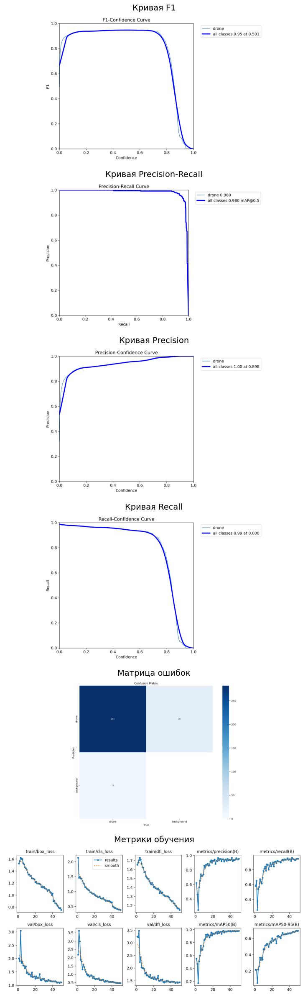

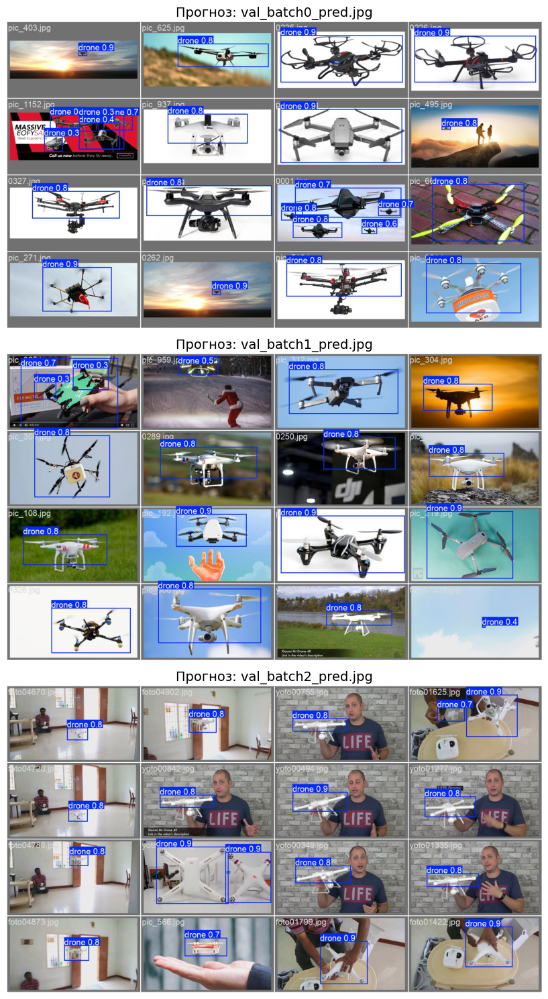

In [21]:
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os

# Путь к папке результатов
result_path = "/kaggle/working/runs/detect/train"

metrics = [
    ('F1_curve.png', 'Кривая F1'),
    ('PR_curve.png', 'Кривая Precision-Recall'),
    ('P_curve.png', 'Кривая Precision'),
    ('R_curve.png', 'Кривая Recall'),
    ('confusion_matrix.png', 'Матрица ошибок'),
    ('results.png', 'Метрики обучения')
]

#  метрики в столбик, увеличиваем ширину
fig, axs = plt.subplots(len(metrics), 1, figsize=(16, len(metrics)*4))

for ax, (file, title) in zip(axs, metrics):
    img = Image.open(os.path.join(result_path, file))
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(title, fontsize=14)

plt.tight_layout()
plt.show()

#  предсказания на валидации, тоже делаем шире
val_imgs = ['val_batch0_pred.jpg', 'val_batch1_pred.jpg', 'val_batch2_pred.jpg']

fig, axs = plt.subplots(len(val_imgs), 1, figsize=(16, len(val_imgs)*5))
for ax, file in zip(axs, val_imgs):
    img = Image.open(os.path.join(result_path, file))
    ax.imshow(img)
    ax.axis('off')
    ax.set_title('Прогноз: ' + file, fontsize=14)

plt.tight_layout()
plt.show()



In [22]:
import pandas as pd


csv_path = "/kaggle/working/runs/detect/train/results.csv"
df = pd.read_csv(csv_path)


df.head()

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,22.6960,1.52472,2.13750,1.65366,0.62232,0.58362,0.55238,0.21517,2.00748,2.18258,3.24484,0.000657,0.000657,0.000657
1,2,43.4664,1.56718,1.46229,1.67772,0.46117,0.65188,0.47053,0.21337,1.90613,3.62278,3.22613,0.001297,0.001297,0.001297
2,3,65.3232,1.62233,1.49399,1.70406,0.24844,0.25939,0.17796,0.05375,3.04499,2.98599,3.47825,0.001911,0.001911,0.001911
3,4,87.0003,1.60291,1.44007,1.73235,0.56329,0.53925,0.51054,0.22183,1.83498,1.87699,2.23928,0.001881,0.001881,0.001881
4,5,109.5840,1.60034,1.43027,1.70880,0.65451,0.56997,0.60006,0.26061,1.88263,1.78247,2.43768,0.001842,0.001842,0.001842


In [23]:
df.tail()

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
45,46,1010.57,0.81902,0.42287,1.19428,0.94361,0.93515,0.97374,0.68033,1.10292,0.49639,1.43635,0.000218,0.000218,0.000218
46,47,1032.11,0.79299,0.40858,1.17425,0.96465,0.93136,0.97637,0.68526,1.10917,0.48668,1.44530,0.000178,0.000178,0.000178
47,48,1053.89,0.78141,0.39727,1.16696,0.95192,0.94598,0.97955,0.69339,1.08162,0.48360,1.41991,0.000139,0.000139,0.000139
48,49,1075.62,0.78468,0.40139,1.16724,0.94668,0.94881,0.97751,0.69089,1.10617,0.48180,1.43609,0.000099,0.000099,0.000099
49,50,1097.16,0.75259,0.38225,1.14965,0.95659,0.94881,0.98043,0.69295,1.10487,0.47896,1.43863,0.000060,0.000060,0.000060


In [24]:
# !cp /kaggle/working/runs/detect/train/weights/best.pt /kaggle/working/best.pt
# # 

In [25]:
model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

# простой собранный тест из разных датасетов
test_folder = "/kaggle/input/my-drone-test1/"

results = model.predict(source=test_folder, save=True)




image 1/16 /kaggle/input/my-drone-test1/UAVS_10.jpg: 480x640 1 drone, 13.8ms
image 2/16 /kaggle/input/my-drone-test1/UAVS_11.jpg: 320x640 1 drone, 11.1ms
image 3/16 /kaggle/input/my-drone-test1/UAVS_12.jpg: 448x640 1 drone, 13.6ms
image 4/16 /kaggle/input/my-drone-test1/UAVS_13.jpg: 352x640 1 drone, 11.2ms
image 5/16 /kaggle/input/my-drone-test1/UAVS_2.jpg: 224x640 1 drone, 9.1ms
image 6/16 /kaggle/input/my-drone-test1/UAVS_228.jpg: 640x640 1 drone, 17.2ms
image 7/16 /kaggle/input/my-drone-test1/UAVS_229.jpg: 576x640 1 drone, 16.6ms
image 8/16 /kaggle/input/my-drone-test1/UAVS_230.jpg: 352x640 1 drone, 11.2ms
image 9/16 /kaggle/input/my-drone-test1/UAVS_231.jpg: 160x640 1 drone, 8.7ms
image 10/16 /kaggle/input/my-drone-test1/UAVS_3.jpg: 416x640 1 drone, 13.4ms
image 11/16 /kaggle/input/my-drone-test1/UAVS_4.jpg: 416x640 1 drone, 12.6ms
image 12/16 /kaggle/input/my-drone-test1/UAVS_5.jpg: 416x640 1 drone, 12.7ms
image 13/16 /kaggle/input/my-drone-test1/UAVS_6.jpg: 480x640 1 drone, 13.8

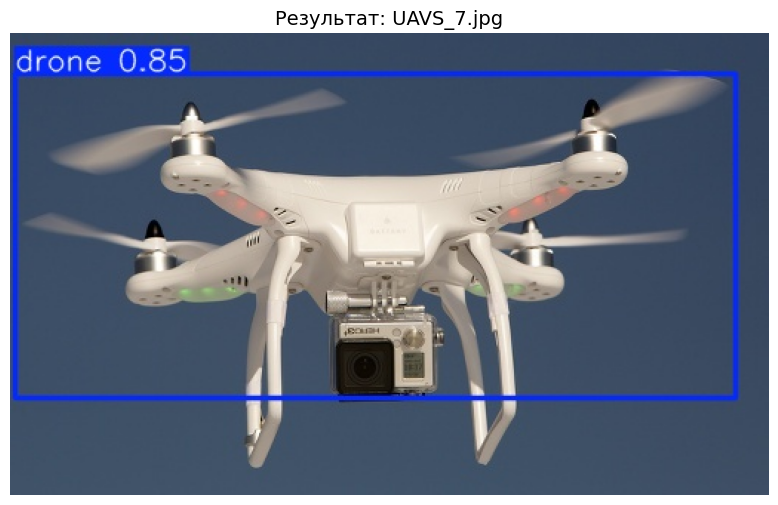

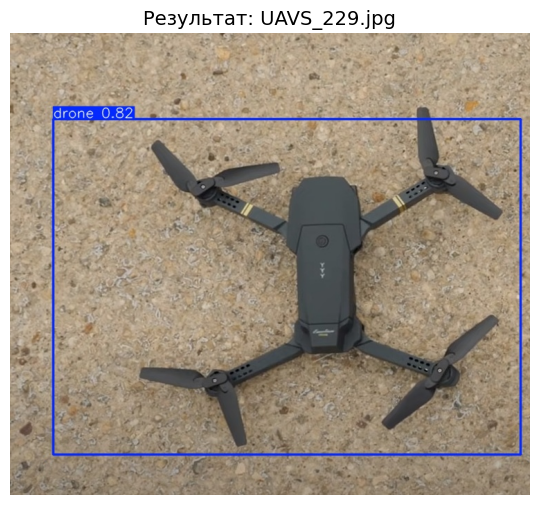

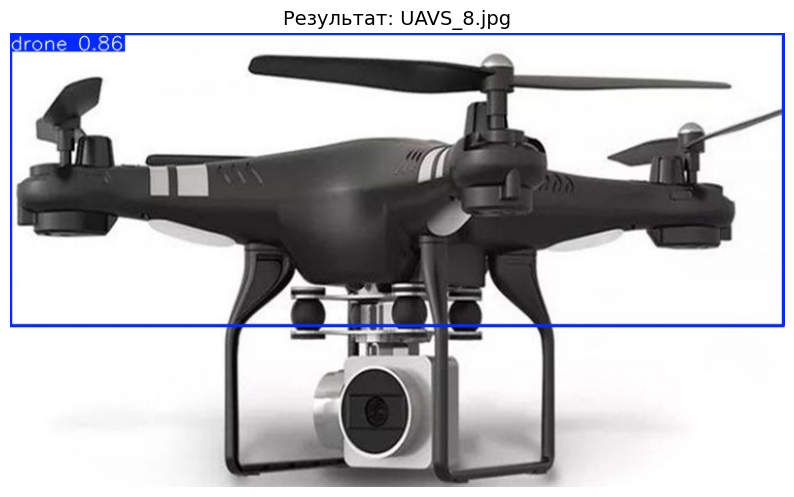

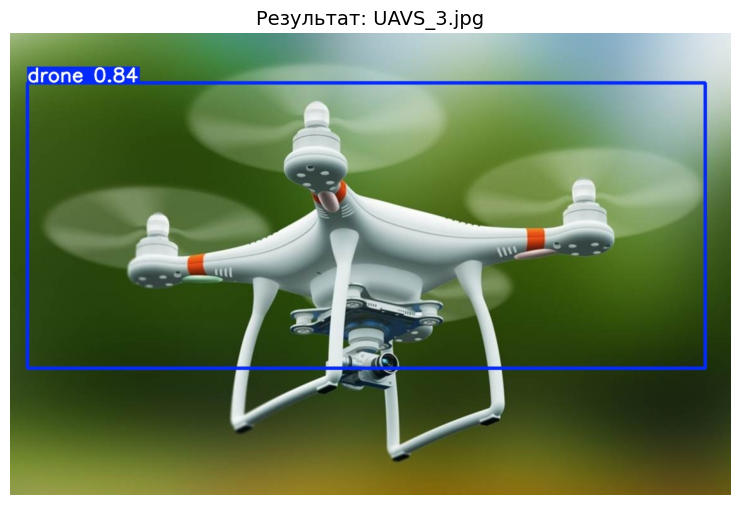

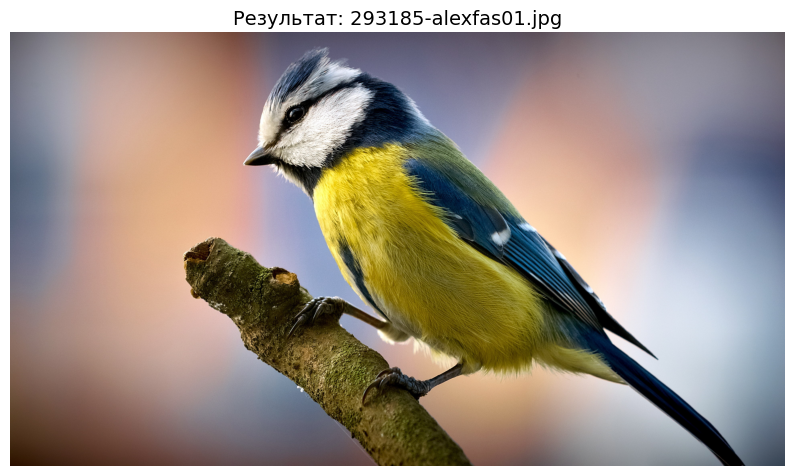

...

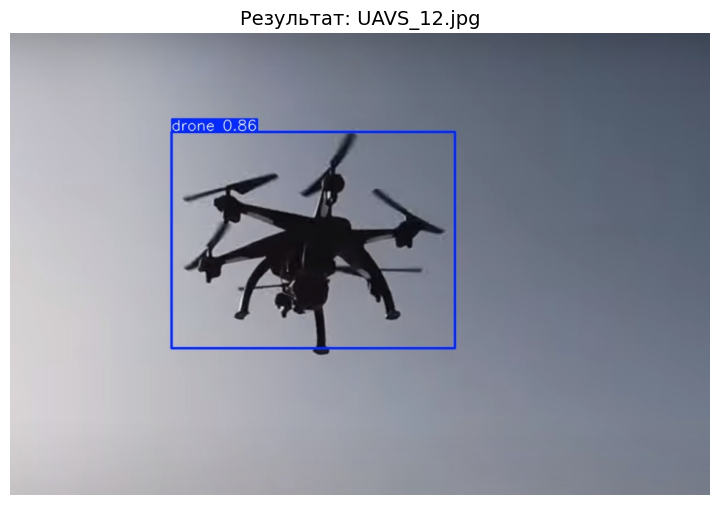

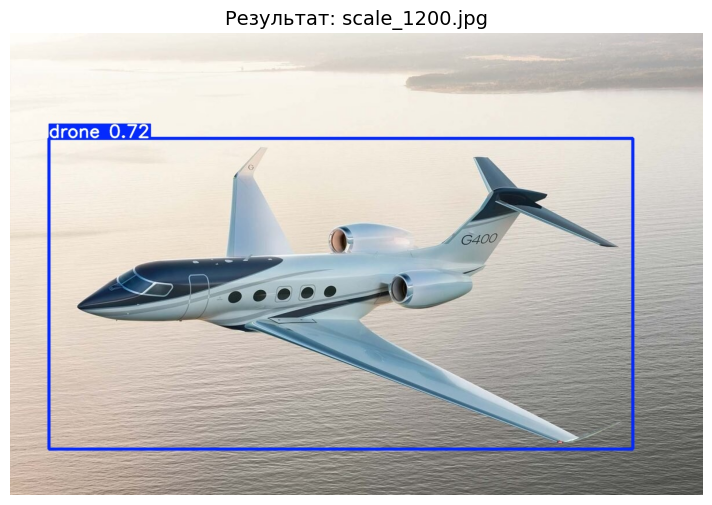

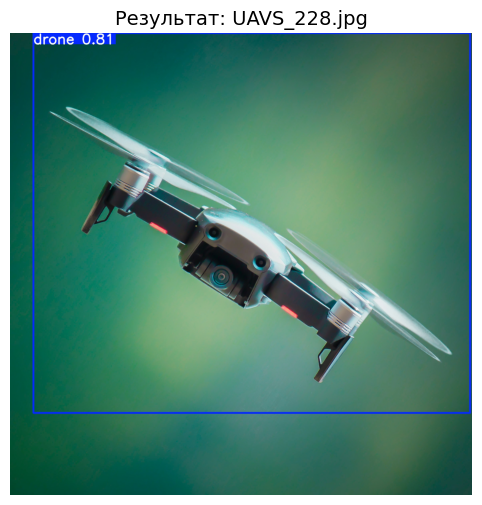

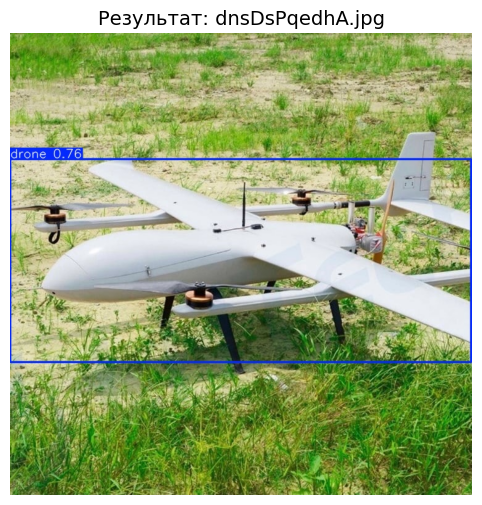

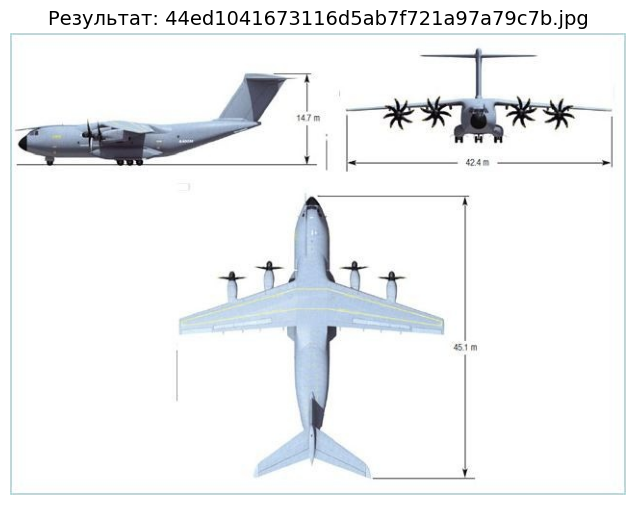

In [26]:
# путь к папке с предсказаниями
predict_path = "/kaggle/working/runs/detect/predict"

# список всех картинок (фильтруем по .jpg, .png)
img_files = [f for f in os.listdir(predict_path) if f.endswith(('.jpg', '.png'))]

# выводим все картинки
for img_file in img_files:
    img = Image.open(os.path.join(predict_path, img_file))
    plt.figure(figsize=(10,6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Результат: {img_file}", fontsize=14)
    plt.show()

In [27]:
test_folder = "/kaggle/input/my-drone-test-v-trash"

results = model.predict(source=test_folder, save=True)


image 1/23 /kaggle/input/my-drone-test-v-trash/293185-alexfas01.jpg: 384x640 1 drone, 11.6ms
image 2/23 /kaggle/input/my-drone-test-v-trash/44ed1041673116d5ab7f721a97a79c7b.jpg: 480x640 1 drone, 13.9ms
image 3/23 /kaggle/input/my-drone-test-v-trash/UAVS_10.jpg: 480x640 1 drone, 13.1ms
image 4/23 /kaggle/input/my-drone-test-v-trash/UAVS_11.jpg: 320x640 1 drone, 11.1ms
image 5/23 /kaggle/input/my-drone-test-v-trash/UAVS_12.jpg: 448x640 1 drone, 13.6ms
image 6/23 /kaggle/input/my-drone-test-v-trash/UAVS_13.jpg: 352x640 1 drone, 11.3ms
image 7/23 /kaggle/input/my-drone-test-v-trash/UAVS_2.jpg: 224x640 1 drone, 9.1ms
image 8/23 /kaggle/input/my-drone-test-v-trash/UAVS_228.jpg: 640x640 1 drone, 17.2ms
image 9/23 /kaggle/input/my-drone-test-v-trash/UAVS_229.jpg: 576x640 1 drone, 16.6ms
image 10/23 /kaggle/input/my-drone-test-v-trash/UAVS_230.jpg: 352x640 1 drone, 11.3ms
image 11/23 /kaggle/input/my-drone-test-v-trash/UAVS_231.jpg: 160x640 1 drone, 8.6ms
image 12/23 /kaggle/input/my-drone-tes

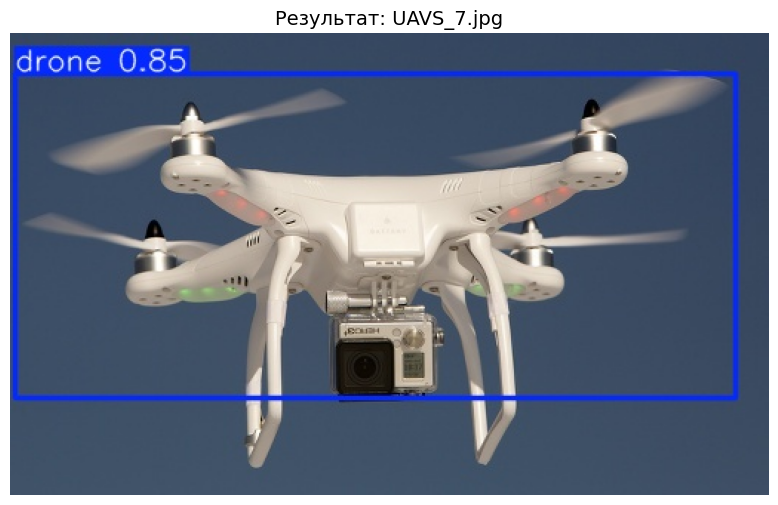

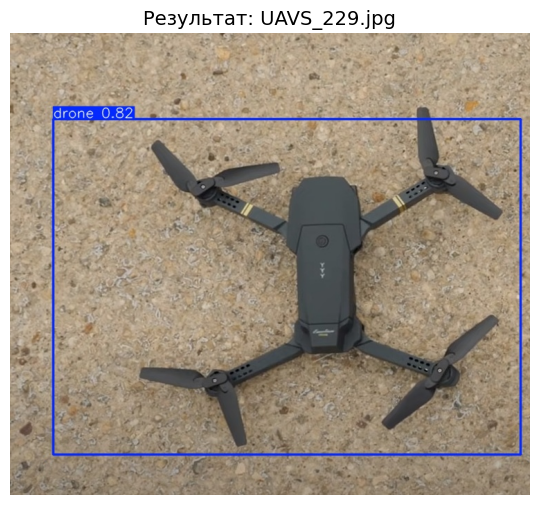

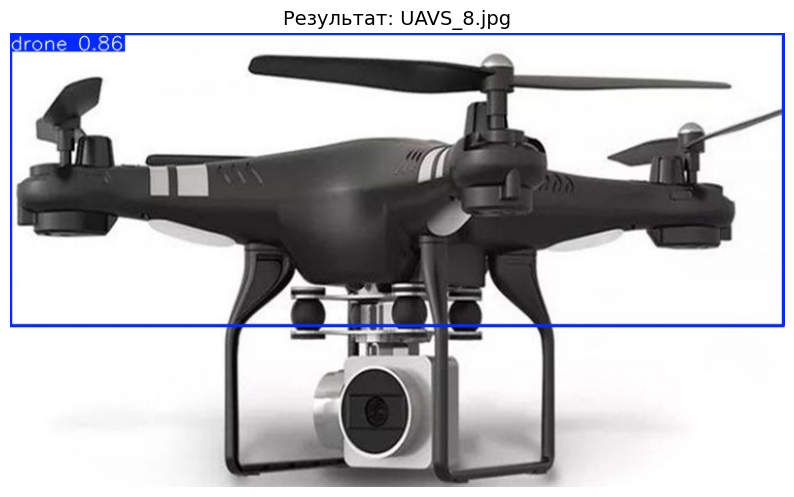

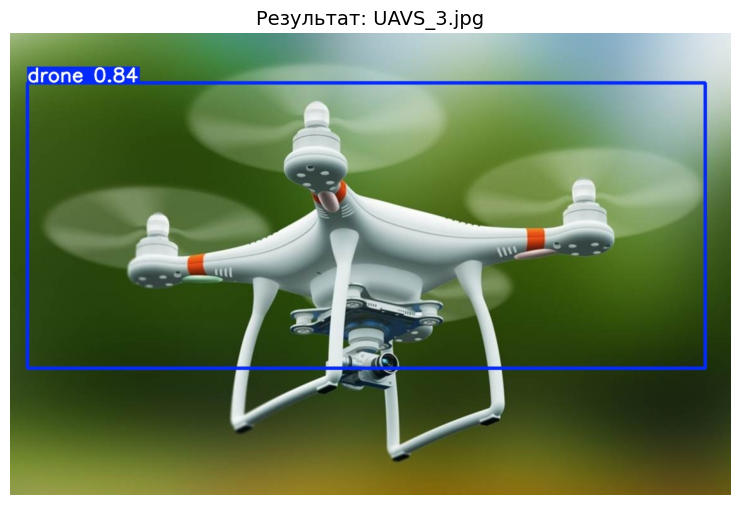

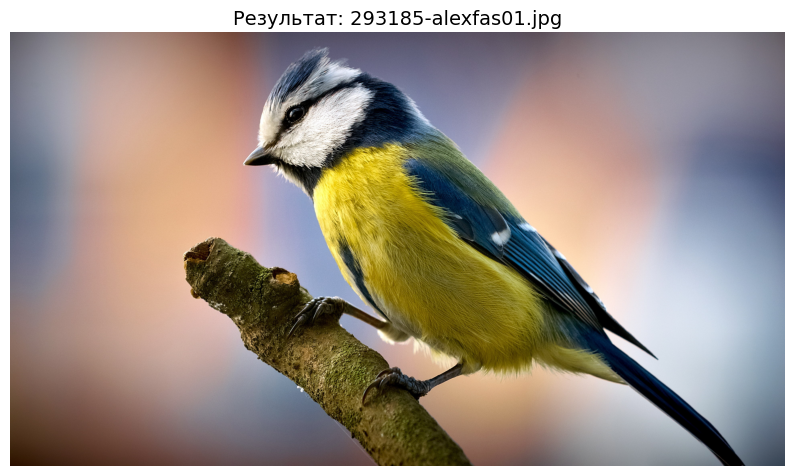

...

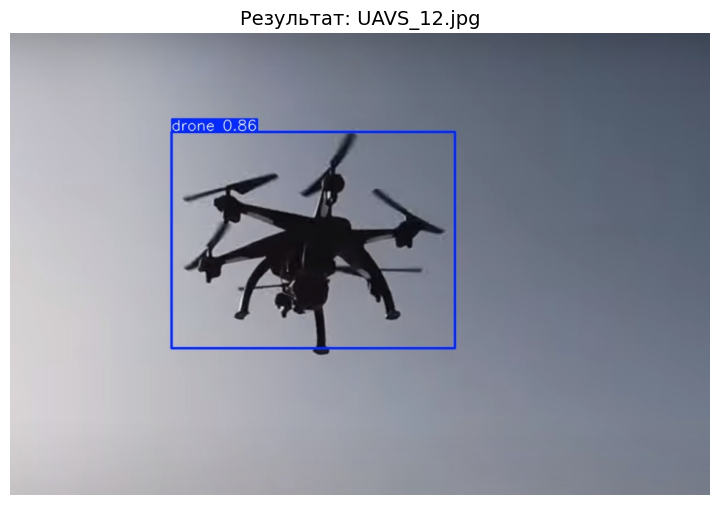

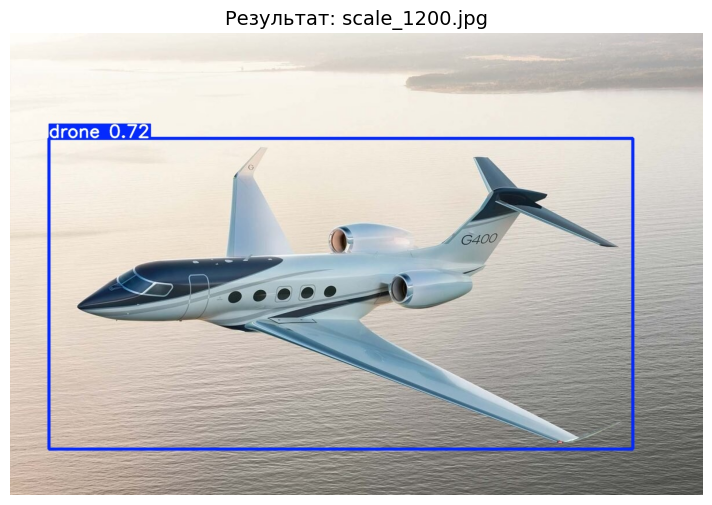

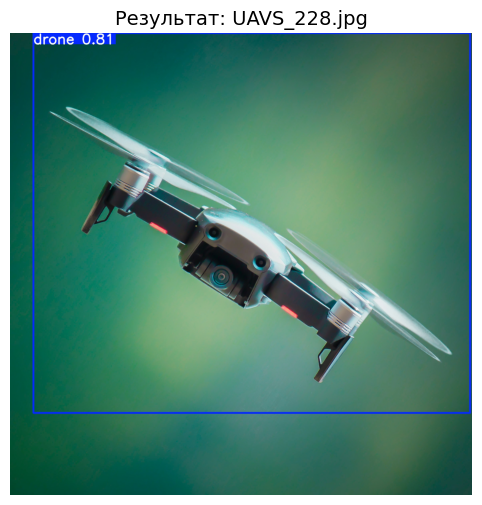

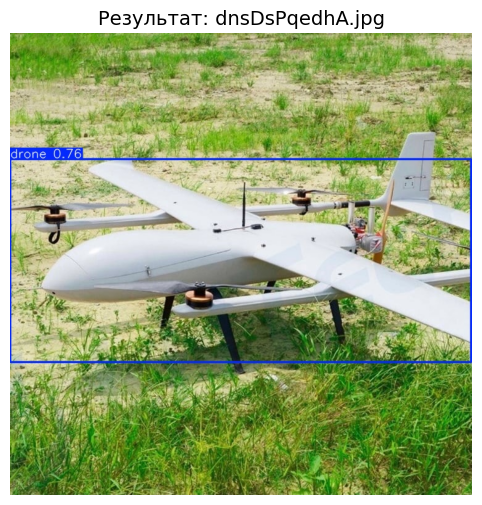

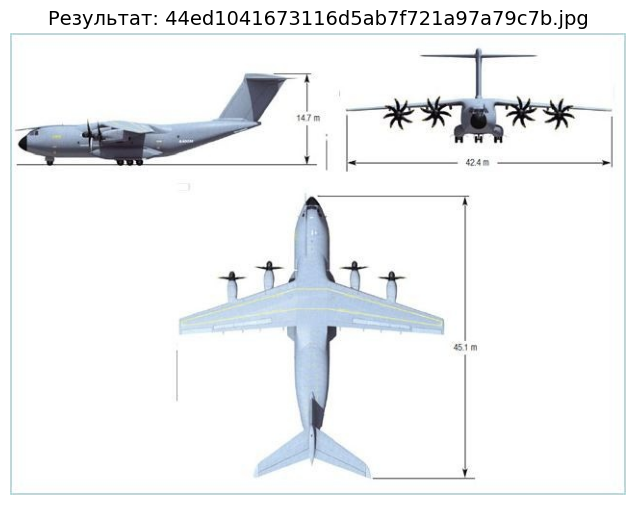

In [28]:
# путь к папке с предсказаниями
predict_path = "/kaggle/working/runs/detect/predict"

# список всех картинок (фильтруем по .jpg, .png)
img_files = [f for f in os.listdir(predict_path) if f.endswith(('.jpg', '.png'))]

# выводим все картинки
for img_file in img_files:
    img = Image.open(os.path.join(predict_path, img_file))
    plt.figure(figsize=(10,6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Результат: {img_file}", fontsize=14)
    plt.show()
    

In [29]:
test_folder = "/kaggle/input/my-drone-test-v-trash"

results = model.predict(source=test_folder, conf = 0.7, save=True)


image 1/23 /kaggle/input/my-drone-test-v-trash/293185-alexfas01.jpg: 384x640 (no detections), 11.5ms
image 2/23 /kaggle/input/my-drone-test-v-trash/44ed1041673116d5ab7f721a97a79c7b.jpg: 480x640 (no detections), 13.9ms
image 3/23 /kaggle/input/my-drone-test-v-trash/UAVS_10.jpg: 480x640 1 drone, 13.1ms
image 4/23 /kaggle/input/my-drone-test-v-trash/UAVS_11.jpg: 320x640 1 drone, 11.1ms
image 5/23 /kaggle/input/my-drone-test-v-trash/UAVS_12.jpg: 448x640 1 drone, 13.6ms
image 6/23 /kaggle/input/my-drone-test-v-trash/UAVS_13.jpg: 352x640 1 drone, 11.2ms
image 7/23 /kaggle/input/my-drone-test-v-trash/UAVS_2.jpg: 224x640 1 drone, 9.1ms
image 8/23 /kaggle/input/my-drone-test-v-trash/UAVS_228.jpg: 640x640 1 drone, 17.0ms
image 9/23 /kaggle/input/my-drone-test-v-trash/UAVS_229.jpg: 576x640 1 drone, 15.3ms
image 10/23 /kaggle/input/my-drone-test-v-trash/UAVS_230.jpg: 352x640 1 drone, 10.5ms
image 11/23 /kaggle/input/my-drone-test-v-trash/UAVS_231.jpg: 160x640 1 drone, 8.0ms
image 12/23 /kaggle/in

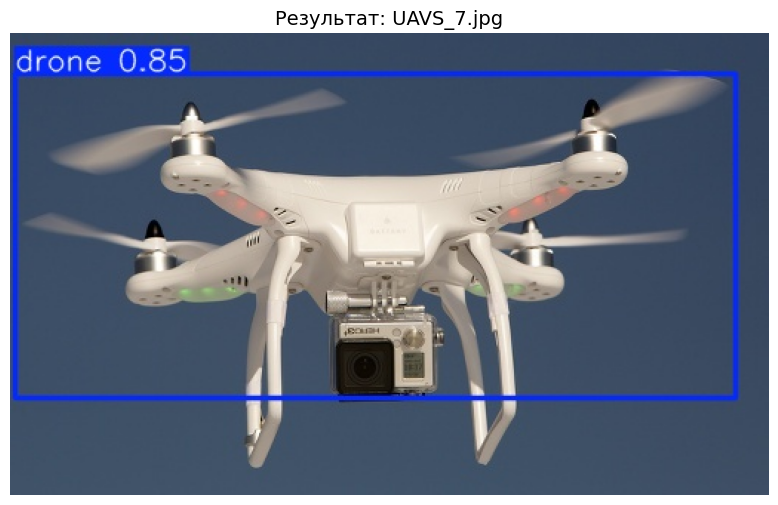

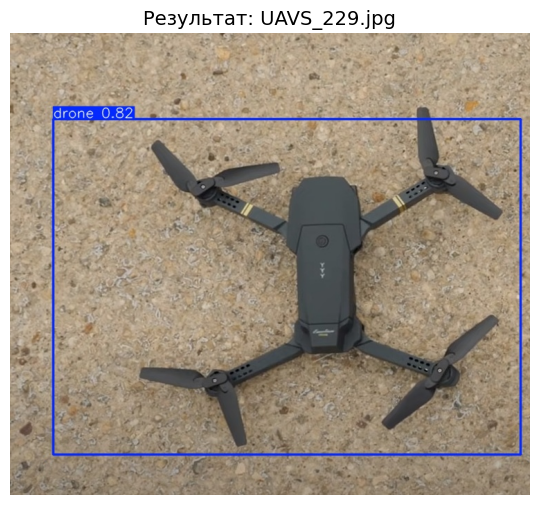

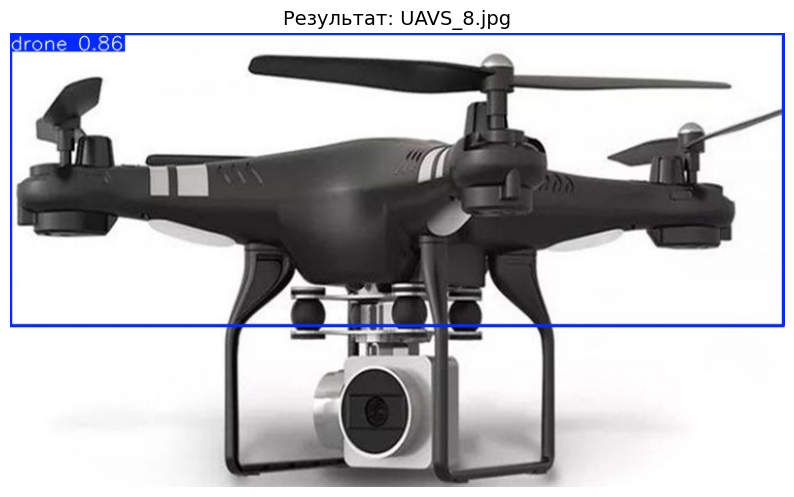

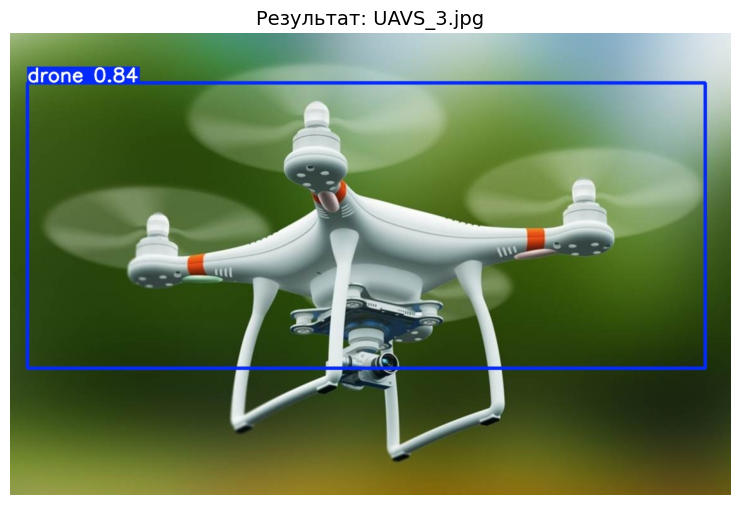

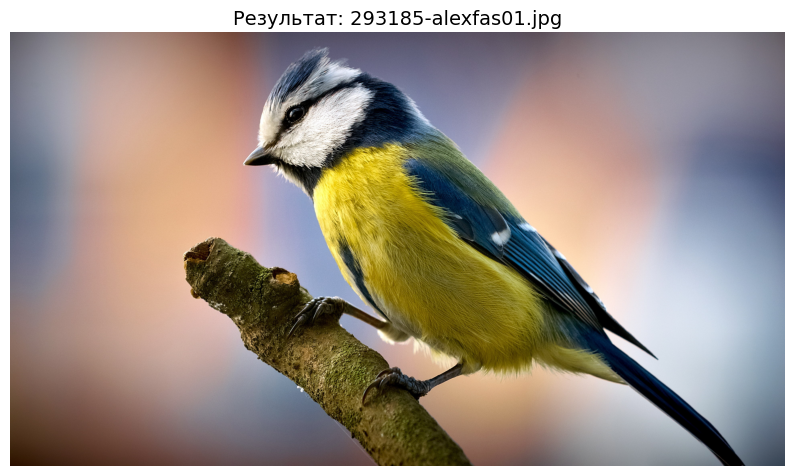

...

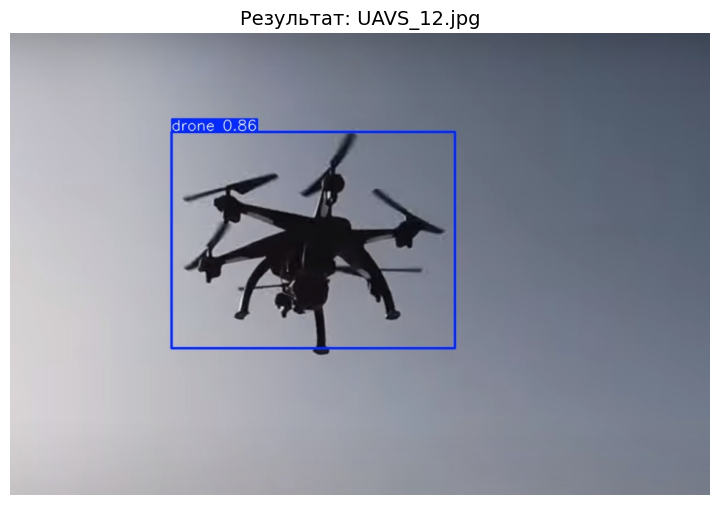

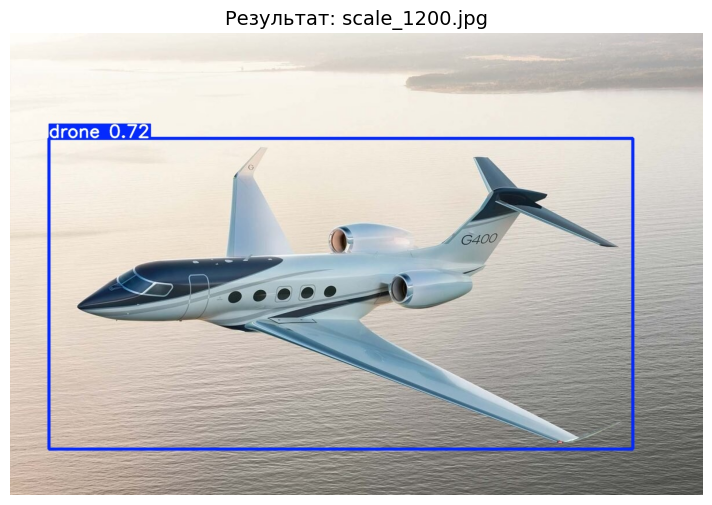

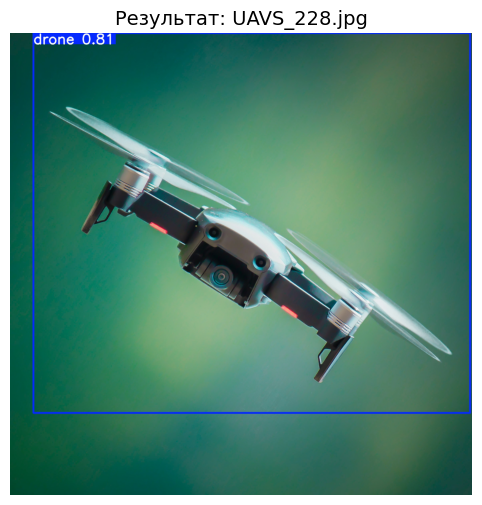

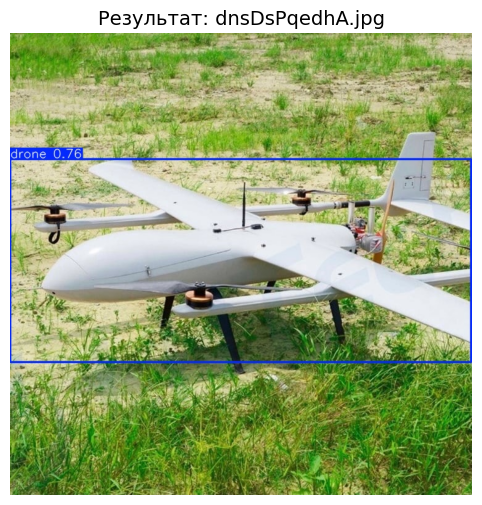

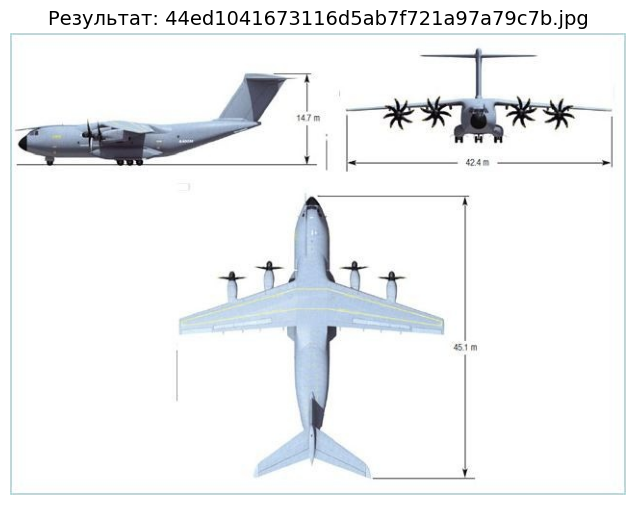

In [30]:
# путь к папке с предсказаниями
predict_path = "/kaggle/working/runs/detect/predict"

# список всех картинок (фильтруем по .jpg, .png)
img_files = [f for f in os.listdir(predict_path) if f.endswith(('.jpg', '.png'))]

# выводим все картинки
for img_file in img_files:
    img = Image.open(os.path.join(predict_path, img_file))
    plt.figure(figsize=(10,6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Результат: {img_file}", fontsize=14)
    plt.show()
    

In [31]:
# Загружаем ранее обученную модель
model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

# Запускаем дообучение
model.train(data='/kaggle/working/dataset/data.yaml', epochs=20)

Ultralytics 8.3.132 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/dataset/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/kaggle/working/runs/detect/train/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train4, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, persp

train: Scanning /kaggle/working/dataset/labels/train.cache... 1087 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1087/1087 [00:00<?, ?it/s]

train: /kaggle/working/dataset/images/train/pic_722.jpg: corrupt JPEG restored and saved
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 450.9±168.0 MB/s, size: 513.4 KB)


val: Scanning /kaggle/working/dataset/labels/val.cache... 272 images, 0 backgrounds, 0 corrupt: 100%|██████████| 272/272 [00:00<?, ?it/s]


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train4
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      3.67G      1.001     0.6324      1.258         47        640:  71%|███████   | 48/68 [00:14<00:06,  3.33it/s]libpng warning: iCCP: known incorrect sRGB profile
       1/20      3.67G      1.001     0.6257      1.257         42        640:  94%|█████████▍| 64/68 [00:19<00:01,  3.34it/s]libpng warning: iCCP: known incorrect sRGB profile
       1/20      3.67G      1.002     0.6243      1.257         48        640: 100%|██████████| 68/68 [00:20<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.02it/s]

                   all        272        293      0.949      0.932      0.969      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      4.65G     0.9981     0.6119      1.248         54        640:  19%|█▉        | 13/68 [00:04<00:16,  3.25it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/20      4.65G       1.06     0.6592      1.294         46        640:  75%|███████▌  | 51/68 [00:15<00:04,  3.49it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/20      4.65G      1.082     0.6756      1.301         41        640:  97%|█████████▋| 66/68 [00:19<00:00,  3.43it/s]libpng warning: iCCP: known incorrect sRGB profile
       2/20      4.65G       1.09      0.681      1.306         44        640: 100%|██████████| 68/68 [00:20<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.26it/s]

                   all        272        293      0.934      0.942      0.957      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      4.67G      1.109     0.7329      1.323         42        640:  62%|██████▏   | 42/68 [00:11<00:07,  3.68it/s]libpng warning: iCCP: known incorrect sRGB profile
       3/20      4.67G      1.108     0.7373      1.318         51        640: 100%|██████████| 68/68 [00:19<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.33it/s]

                   all        272        293       0.88      0.884      0.926      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      4.67G      1.134     0.7531      1.342         47        640:  59%|█████▉    | 40/68 [00:11<00:08,  3.46it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/20      4.67G      1.134     0.7515      1.341         44        640:  69%|██████▉   | 47/68 [00:12<00:05,  3.61it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/20      4.67G      1.152      0.767      1.349         40        640:  97%|█████████▋| 66/68 [00:18<00:00,  3.57it/s]libpng warning: iCCP: known incorrect sRGB profile
       4/20      4.67G      1.154     0.7701      1.351         42        640: 100%|██████████| 68/68 [00:18<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.28it/s]

                   all        272        293      0.886      0.878      0.923      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      4.67G      1.148     0.7863      1.349         35        640:  50%|█████     | 34/68 [00:09<00:09,  3.48it/s]libpng warning: iCCP: known incorrect sRGB profile
       5/20      4.67G      1.149     0.7864      1.365         43        640: 100%|██████████| 68/68 [00:19<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.36it/s]

                   all        272        293      0.927      0.867      0.918      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      4.67G      1.136      0.732      1.336         59        640:  31%|███       | 21/68 [00:06<00:13,  3.54it/s]libpng warning: iCCP: known incorrect sRGB profile
       6/20      4.67G      1.117     0.7332       1.33         40        640:  49%|████▊     | 33/68 [00:09<00:10,  3.46it/s]libpng warning: iCCP: known incorrect sRGB profile
       6/20      4.67G      1.131     0.7533      1.341         53        640: 100%|██████████| 68/68 [00:19<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.32it/s]

                   all        272        293      0.904      0.901      0.931      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      4.67G      1.202     0.8062      1.362         45        640:  13%|█▎        | 9/68 [00:02<00:16,  3.63it/s]libpng warning: iCCP: known incorrect sRGB profile
       7/20      4.67G      1.185     0.7873      1.361         46        640:  59%|█████▉    | 40/68 [00:11<00:07,  3.54it/s]libpng warning: iCCP: known incorrect sRGB profile
       7/20      4.67G      1.159     0.7643       1.35         37        640: 100%|██████████| 68/68 [00:19<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.43it/s]

                   all        272        293      0.943      0.901      0.967       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      4.67G      1.167     0.7661      1.367         35        640:  22%|██▏       | 15/68 [00:04<00:14,  3.61it/s]libpng warning: iCCP: known incorrect sRGB profile
       8/20      4.67G      1.147     0.7582      1.367         34        640:  37%|███▋      | 25/68 [00:06<00:12,  3.54it/s]libpng warning: iCCP: known incorrect sRGB profile
       8/20      4.67G      1.132     0.7361      1.346         37        640: 100%|██████████| 68/68 [00:19<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.30it/s]

                   all        272        293      0.936      0.899      0.962      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      4.67G      1.018     0.7213      1.247         40        640:   1%|▏         | 1/68 [00:00<00:18,  3.72it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/20      4.67G      1.064     0.6933      1.291         43        640:  69%|██████▉   | 47/68 [00:13<00:05,  3.52it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/20      4.67G      1.097     0.6977      1.312         46        640:  99%|█████████▊| 67/68 [00:19<00:00,  3.48it/s]libpng warning: iCCP: known incorrect sRGB profile
       9/20      4.67G        1.1      0.699      1.315         39        640: 100%|██████████| 68/68 [00:19<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.29it/s]

                   all        272        293      0.963      0.925      0.968      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      4.67G      1.091     0.6664      1.334         37        640:  63%|██████▎   | 43/68 [00:12<00:07,  3.56it/s]libpng warning: iCCP: known incorrect sRGB profile
      10/20      4.67G       1.09      0.684      1.323         41        640: 100%|██████████| 68/68 [00:19<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.32it/s]

                   all        272        293      0.948      0.931      0.964      0.638


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      4.67G      1.015     0.7305      1.431         16        640:   6%|▌         | 4/68 [00:01<00:25,  2.48it/s]libpng warning: iCCP: known incorrect sRGB profile
      11/20      4.67G     0.9539     0.5773      1.321         16        640:  84%|████████▍ | 57/68 [00:16<00:03,  3.56it/s]libpng warning: iCCP: known incorrect sRGB profile
      11/20      4.67G      0.958     0.5759      1.319         16        640:  94%|█████████▍| 64/68 [00:18<00:01,  3.53it/s]libpng warning: iCCP: known incorrect sRGB profile
      11/20      4.67G     0.9598      0.572      1.322         25        640: 100%|██████████| 68/68 [00:19<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.46it/s]

                   all        272        293      0.952      0.915      0.964      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      4.67G     0.9199     0.5169      1.268         16        640:  62%|██████▏   | 42/68 [00:11<00:07,  3.60it/s]libpng warning: iCCP: known incorrect sRGB profile
      12/20      4.67G     0.9285     0.5193      1.278         16        640:  97%|█████████▋| 66/68 [00:18<00:00,  3.60it/s]libpng warning: iCCP: known incorrect sRGB profile
      12/20      4.67G     0.9295     0.5188      1.277         16        640: 100%|██████████| 68/68 [00:19<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.25it/s]

                   all        272        293      0.927      0.922      0.966      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      4.67G     0.9058     0.4897      1.249         17        640:  51%|█████▏    | 35/68 [00:09<00:09,  3.58it/s]libpng warning: iCCP: known incorrect sRGB profile
      13/20      4.67G     0.9233     0.4982      1.258         25        640: 100%|██████████| 68/68 [00:19<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.45it/s]

                   all        272        293       0.94      0.917      0.968      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      4.67G     0.9724      0.509      1.301         17        640:  25%|██▌       | 17/68 [00:04<00:14,  3.59it/s]libpng warning: iCCP: known incorrect sRGB profile
      14/20      4.67G     0.9197     0.4883      1.263         16        640:  93%|█████████▎| 63/68 [00:17<00:01,  3.58it/s]libpng warning: iCCP: known incorrect sRGB profile
      14/20      4.67G     0.9172     0.4906       1.26         15        640: 100%|██████████| 68/68 [00:19<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.26it/s]

                   all        272        293      0.957      0.915      0.969      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      4.67G     0.8699     0.4622      1.236         17        640:  60%|██████    | 41/68 [00:11<00:07,  3.56it/s]libpng warning: iCCP: known incorrect sRGB profile
      15/20      4.67G      0.863     0.4614      1.226         16        640:  94%|█████████▍| 64/68 [00:17<00:01,  3.55it/s]libpng warning: iCCP: known incorrect sRGB profile
      15/20      4.67G     0.8621     0.4641      1.226         19        640: 100%|██████████| 68/68 [00:18<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.22it/s]

                   all        272        293       0.96      0.922      0.971      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      4.67G     0.8642     0.4653      1.199         16        640:  15%|█▍        | 10/68 [00:02<00:16,  3.56it/s]libpng warning: iCCP: known incorrect sRGB profile
      16/20      4.67G     0.8472     0.4443      1.201         16        640:  60%|██████    | 41/68 [00:11<00:07,  3.59it/s]libpng warning: iCCP: known incorrect sRGB profile
      16/20      4.67G     0.8597     0.4458      1.206         15        640: 100%|██████████| 68/68 [00:19<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.30it/s]

                   all        272        293      0.969      0.925      0.973      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      4.67G     0.8305      0.426      1.196         16        640:  60%|██████    | 41/68 [00:11<00:07,  3.64it/s]libpng warning: iCCP: known incorrect sRGB profile
      17/20      4.67G     0.8276     0.4225      1.192         16        640:  72%|███████▏  | 49/68 [00:13<00:05,  3.51it/s]libpng warning: iCCP: known incorrect sRGB profile
      17/20      4.67G     0.8257     0.4226      1.185         16        640: 100%|██████████| 68/68 [00:19<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.33it/s]

                   all        272        293      0.959      0.925      0.975      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      4.67G     0.8538     0.4458      1.254         19        640:   7%|▋         | 5/68 [00:01<00:17,  3.59it/s]libpng warning: iCCP: known incorrect sRGB profile
      18/20      4.67G     0.8287     0.4206       1.24         16        640:  12%|█▏        | 8/68 [00:02<00:17,  3.53it/s]libpng warning: iCCP: known incorrect sRGB profile
      18/20      4.67G     0.8159     0.4261        1.2         18        640: 100%|██████████| 68/68 [00:19<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.34it/s]

                   all        272        293      0.971      0.901       0.97      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      4.67G     0.7591     0.3915       1.16         16        640:  57%|█████▋    | 39/68 [00:10<00:08,  3.62it/s]libpng warning: iCCP: known incorrect sRGB profile
      19/20      4.67G     0.7721     0.3952      1.169         21        640:  84%|████████▍ | 57/68 [00:16<00:03,  3.54it/s]libpng warning: iCCP: known incorrect sRGB profile
      19/20      4.67G     0.7737     0.3973      1.164         16        640: 100%|██████████| 68/68 [00:19<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.38it/s]

                   all        272        293      0.946      0.928       0.97      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      4.67G     0.7002     0.3582      1.096         16        640:   9%|▉         | 6/68 [00:01<00:17,  3.60it/s]libpng warning: iCCP: known incorrect sRGB profile
      20/20      4.67G     0.7405     0.3942      1.138         17        640:  37%|███▋      | 25/68 [00:06<00:11,  3.59it/s]libpng warning: iCCP: known incorrect sRGB profile
      20/20      4.67G     0.7442      0.382      1.142         16        640: 100%|██████████| 68/68 [00:19<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  4.36it/s]

                   all        272        293      0.943      0.935      0.972      0.692



20 epochs completed in 0.122 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 22.5MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics 8.3.132 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/9 [00:00<?, ?it/s]libpng warning: iCCP: known incorrect sRGB profile
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.32it/s]


                   all        272        293      0.949      0.928       0.97      0.699


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 3.6ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d2be478b890>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

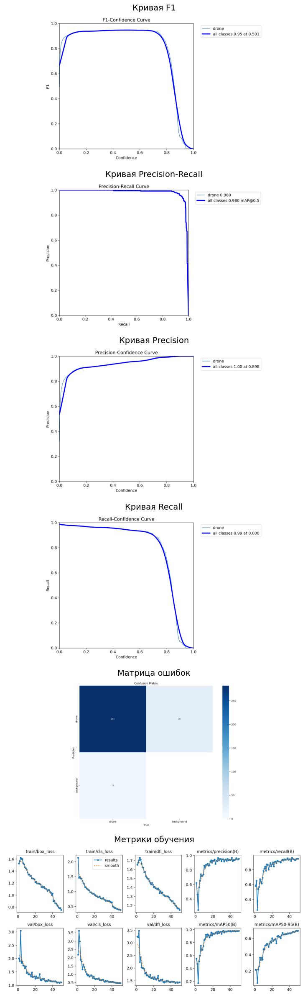

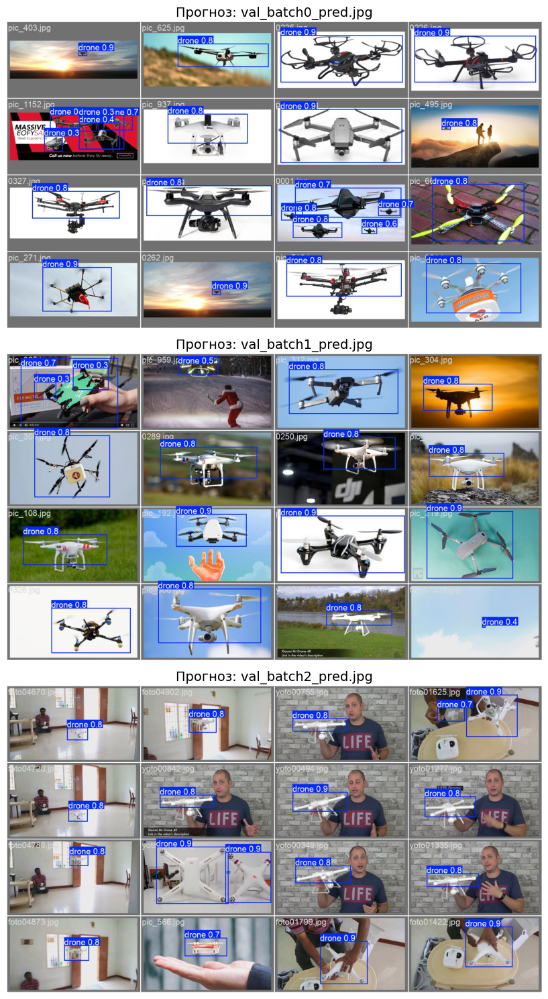

In [32]:
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os

# Путь к папке результатов
result_path = "/kaggle/working/runs/detect/train"

metrics = [
    ('F1_curve.png', 'Кривая F1'),
    ('PR_curve.png', 'Кривая Precision-Recall'),
    ('P_curve.png', 'Кривая Precision'),
    ('R_curve.png', 'Кривая Recall'),
    ('confusion_matrix.png', 'Матрица ошибок'),
    ('results.png', 'Метрики обучения')
]

#  метрики в столбик, увеличиваем ширину
fig, axs = plt.subplots(len(metrics), 1, figsize=(16, len(metrics)*4))

for ax, (file, title) in zip(axs, metrics):
    img = Image.open(os.path.join(result_path, file))
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(title, fontsize=14)

plt.tight_layout()
plt.show()

#  предсказания на валидации, тоже делаем шире
val_imgs = ['val_batch0_pred.jpg', 'val_batch1_pred.jpg', 'val_batch2_pred.jpg']

fig, axs = plt.subplots(len(val_imgs), 1, figsize=(16, len(val_imgs)*5))
for ax, file in zip(axs, val_imgs):
    img = Image.open(os.path.join(result_path, file))
    ax.imshow(img)
    ax.axis('off')
    ax.set_title('Прогноз: ' + file, fontsize=14)

plt.tight_layout()
plt.show()

